### Scale Assessment: CFA

In [1]:
library(lavaan)
library(semTools)
library(semPlot)

This is lavaan 0.5-20
lavaan is BETA software! Please report any bugs.
 
###############################################################################
This is semTools 0.4-9
All users of R (or SEM) are invited to submit functions or ideas for functions.
###############################################################################
Warning message:
: replacing previous import by ‘ggplot2::unit’ when loading ‘Hmisc’Warning message:
: replacing previous import by ‘ggplot2::arrow’ when loading ‘Hmisc’Warning message:
: replacing previous import by ‘scales::alpha’ when loading ‘Hmisc’

In [6]:
# define the hierarchical structural model
piesModel <- " General =~ i1 + i2 + i3
               Feature =~ i4 + i5 + i6  + i7
               Image   =~ i8 + i9 + i10 + i11
               PIES =~ General + Feature + Image "

In [7]:
# specify population model
piesDataModel <- " General =~ 0.9*i1 + 0.7*i2 + 0.5*i3
                   Feature =~ 0.3*i3 + 0.7*i4 + 0.9*i5 + 0.5*i6  + 0.9*i7
                   Image   =~ 0.2*i3 + 0.8*i8 + 0.9*i9 + 0.8*i10 + 0.7*i11 
                   PIES =~ 0.7*General + 0.8*Feature + 0.8*Image"

In [8]:
set.seed(10001)    # another island Zip code
piesSimData.norm <- simulateData(piesDataModel, sample.nobs=3600)
print(head(piesSimData.norm), digits=2)

Found more than one class "Model" in cache; using the first, from namespace 'lavaan'


     i1    i2    i3     i4    i5    i6    i7     i8    i9    i10    i11
1 -0.16  2.07  1.14 -1.746 -1.68 -1.79 -1.46 -0.032  1.82  0.610 -0.032
2 -0.38  2.27  0.79  0.922  0.23  0.35  0.51  0.963 -1.11 -0.037  0.792
3 -0.65 -3.00  0.25 -0.077 -0.35  0.12 -1.63 -0.766 -0.22 -1.220  0.462
4  0.63 -1.00  1.18 -2.153 -3.16 -0.57 -0.41 -1.369 -1.56 -0.844 -1.801
5 -0.57 -0.54 -0.94  0.426  0.45 -0.72  0.63 -1.054 -0.47 -2.449 -0.276
6 -0.75  0.54 -0.37  0.796 -0.49 -0.94 -0.81  1.080  3.09  0.704  2.406


In [9]:
# convert the real numbers to 1-7 scale faux-Likert items
piesSimData <- data.frame(lapply(piesSimData.norm, 
                          function(x) { cut(x, breaks=7, labels=FALSE) } ))

In [10]:
library(car)
some(piesSimData)

,i1,i2,i3,i4,i5,i6,i7,i8,i9,i10,i11
11,3,3,4,2,2,5,3,2,4,3,4
709,3,3,3,5,4,3,3,3,4,4,4
1392,4,3,3,3,4,4,3,4,4,5,4
1705,4,3,5,3,4,4,4,4,5,5,3
2638,6,6,5,4,5,4,5,4,5,3,4
2792,3,2,3,3,3,4,3,3,4,3,3
3003,4,4,3,5,4,3,5,2,3,3,2
3305,5,4,5,3,3,3,2,3,3,2,2
3550,4,5,4,4,2,5,3,2,2,3,3
3553,5,4,6,5,4,4,5,3,3,2,3


In [11]:
library(psych)
describe(piesSimData)


Attaching package: ‘psych’

The following object is masked from ‘package:car’:

    logit

The following object is masked from ‘package:semTools’:

    skew



,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
i1,1,3600,4.338889,0.9971557,4,4.322569,1.4826,1,7,6,-0.06620496,-0.009746179,0.01661926
i2,2,3600,4.104444,1.048521,4,4.093403,1.4826,1,7,6,-0.01105498,-0.07122318,0.01747535
i3,3,3600,4.110278,1.018203,4,4.100347,1.4826,1,7,6,-0.006904868,-0.1318895,0.01697005
i4,4,3600,4.038889,1.050352,4,4.044097,1.4826,1,7,6,-0.07321901,-0.04965788,0.01750586
i5,5,3600,3.999167,1.0786,4,3.995486,1.4826,1,7,6,-0.02491117,-0.0719634,0.01797667
i6,6,3600,3.922222,1.039672,4,3.940278,1.4826,1,7,6,-0.07874765,0.02401658,0.01732786
i7,7,3600,3.872222,1.044604,4,3.883681,1.4826,1,7,6,0.021188,-0.103334,0.01741007
i8,8,3600,3.903889,1.109552,4,3.91875,1.4826,1,7,6,0.01682311,-0.1229336,0.01849253
i9,9,3600,4.023333,1.01202,4,4.008681,1.4826,1,7,6,0.07073289,-0.05332764,0.016867
i10,10,3600,3.9,1.023209,4,3.917708,1.4826,1,7,6,-0.04045093,0.04689881,0.01705349


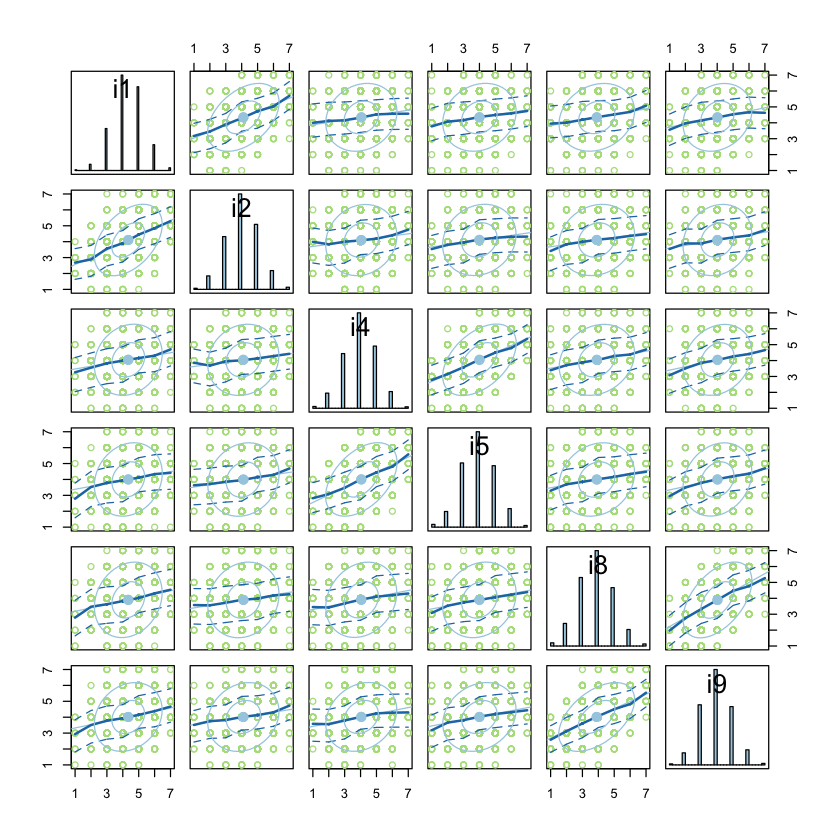

In [12]:
library(car)
library(RColorBrewer)
scatterplotMatrix(piesSimData[, c(1, 2, 4, 5, 8, 9)], diag="histogram",
                  col=brewer.pal(3, "Paired"), ellipse=TRUE )

In [13]:
factanal(piesSimData, factors=3)


Call:
factanal(x = piesSimData, factors = 3)

Uniquenesses:
   i1    i2    i3    i4    i5    i6    i7    i8    i9   i10   i11 
0.511 0.604 0.565 0.598 0.462 0.717 0.499 0.522 0.466 0.536 0.577 

Loadings:
    Factor1 Factor2 Factor3
i1  0.138   0.119   0.675  
i2                  0.614  
i3  0.277   0.362   0.476  
i4  0.151   0.608          
i5  0.126   0.715   0.102  
i6          0.519          
i7  0.133   0.678   0.154  
i8  0.665   0.137   0.128  
i9  0.706   0.138   0.130  
i10 0.655   0.117   0.145  
i11 0.632   0.126          

               Factor1 Factor2 Factor3
SS loadings      1.937   1.833   1.172
Proportion Var   0.176   0.167   0.107
Cumulative Var   0.176   0.343   0.449

Test of the hypothesis that 3 factors are sufficient.
The chi square statistic is 17.14 on 25 degrees of freedom.
The p-value is 0.877 

In [14]:
pies.fit <- cfa(piesModel, data=piesSimData)
summary(pies.fit, fit.measures=TRUE)

lavaan (0.5-20) converged normally after  41 iterations

  Number of observations                          3600

  Estimator                                         ML
  Minimum Function Test Statistic              287.649
  Degrees of freedom                                41
  P-value (Chi-square)                           0.000

Model test baseline model:

  Minimum Function Test Statistic             9920.901
  Degrees of freedom                                55
  P-value                                        0.000

User model versus baseline model:

  Comparative Fit Index (CFI)                    0.975
  Tucker-Lewis Index (TLI)                       0.966

Loglikelihood and Information Criteria:

  Loglikelihood user model (H0)             -52885.888
  Loglikelihood unrestricted model (H1)     -52742.064

  Number of free parameters                         25
  Akaike (AIC)                              105821.776
  Bayesian (BIC)                            105976.494
  Sample-

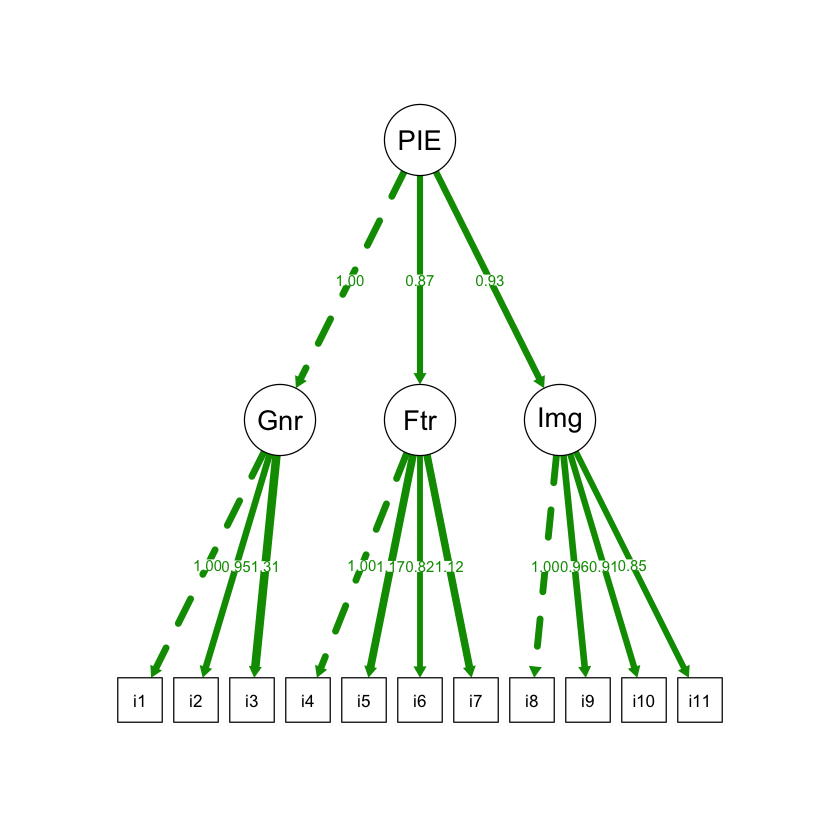

In [15]:
library(semPlot)
semPaths(pies.fit, what="est", fade=FALSE, residuals=FALSE, edge.label.cex=0.75)

In [16]:
# a 1-factor version: single PIES factor for all items
piesModelNH1 <- " PIES =~ i1 + i2 + i3 + i4 + i5 + i6  + 
                          i7 + i8 + i9 + i10 + i11 "
pies.fit.NH1 <- cfa(piesModelNH1, data=piesSimData)

In [17]:
# a 3-factor, non-Hierarchical model. Remove PIES upper level factor,
# and assert that factors are only slightly correlated
#
# this model is nested within the general PIES model, as it asserts three
# factors but with correlation among them fixed to 0.1 (nuisance covariance)
piesModelNH3 <- " General =~ i1 + i2 + i3
                  Feature =~ i4 + i5 + i6  + i7
                  Image   =~ i8 + i9 + i10 + i11
                  General ~~ 0.1*Feature
                  General ~~ 0.1*Image
                  Feature ~~ 0.1*Image "
pies.fit.NH3 <- cfa(piesModelNH3, data=piesSimData)

In [18]:
library(semTools)
compareFit(pies.fit.NH1, pies.fit.NH3, pies.fit)

################### Nested Model Comparison #########################
                                chi df      p delta.cfi
pies.fit - pies.fit.NH3      222.43  3  <.001    0.0222
pies.fit.NH3 - pies.fit.NH1 2774.50  0  <.001    0.2812

#################### Fit Indices Summaries ##########################
                chisq df pvalue   cfi   tli         aic         bic rmsea  srmr
pies.fit.NH1 3284.581 44  .000† .672  .589  108812.709  108948.860  .143  .102 
pies.fit.NH3  510.078 44  .000† .953  .941  106038.205  106174.356  .054  .078 
pies.fit      287.649 41  .000† .975† .966† 105821.776† 105976.494† .041† .030†

What does this mean for us as marketers? It means that, if we saw such results in a product category of interest to us, we would not assume that product involvement is a unitary, single factor. Instead, we would wish to use the somewhat more infor- mative and differentiated hierarchical model that assesses overall product interest alongside measures of feature and image involvement. 

For marketers, there is another implication: when we devise a survey scale, we should test the assumed factor model to ensure that it meets our expectation. Imag- ine that we write a survey that asks about product preferences in four areas: perfor- mance, price, appearance, and quality. If each area has a few survey items and we add them together—as is common with surveys—then we are implicitly asserting a four-factor model for our survey. Before we use those added-up scores, we should check our assumption about factors. Does our model match the data as we believe it should? If not, we might draw very misleading conclusions from the data. Test the model! R and lavaan make it easy to do this in just a few lines of code.


### General Models: Structural Equation Models

![sem](sem.png)
As marketers, if we had collected consumer data from a survey such as this, we would have two goals. First, as we did with CFA above, we would wish to as- certain whether our proposed model of influence—for example, that perception of cost is associated with both perception of value and intent to repurchase, as shown in Fig. 10.7—is an adequate model for the data we have collected. Second, if the model fits the data well, we would answer questions about the relationships: how much does perception of quality relate to satisfaction? Is quality more important than perceived value? What is the largest determinant of stated intent to purchase again?

In [19]:
# first define the theoretical model
# specifying Quality =~ 0 * Cost because of odd results otherwise;
# this matches Iacobucci's CFA results (p. 676) where Quality~Price = -0.03.
# Also we want to take them as separate, orthogonal influences here
# Quality influences CSat and Value, and is man- ifested as items q1, q2, and q3
satModel <- " Quality =~ CSat + Value + q1 + q2 + q3  + 0*Cost
              Cost    =~ Value + Repeat + c1 + c2 + c3
              Value   =~ CSat + v1 + v2 + v3
              CSat    =~ Repeat + cs1 + cs2 + cs3
              Repeat  =~ r1 + r2 + r3 "

In [20]:
satDataModel <- " Quality =~  0.59*CSat + 0.56*Value + 
                              0.9*q1 + 0.9*q2 + 0.9*q3 + 0*Cost
                  Cost    =~ -0.5*Value + -0.29*Repeat + 
                              0.9*c1 + 0.9*c2 + 0.9*c3
                  Value   =~  0.06*CSat + 0.9*v1 + 0.9*v2 + 0.9*v3
                  CSat    =~  0.48*Repeat + 0.9*cs1 + 0.9*cs2 + 0.9*cs3
                  Repeat  =~  0.9*r1 + 0.9*r2 + 0.9*r3 "

In [21]:
set.seed(33706)  # continuing the island tour
satData.norm <- simulateData(satDataModel, sample.nobs=200)
satSimData <- data.frame(lapply(satData.norm, 
                          function(x) { as.numeric(cut(x, breaks=7)) } ))

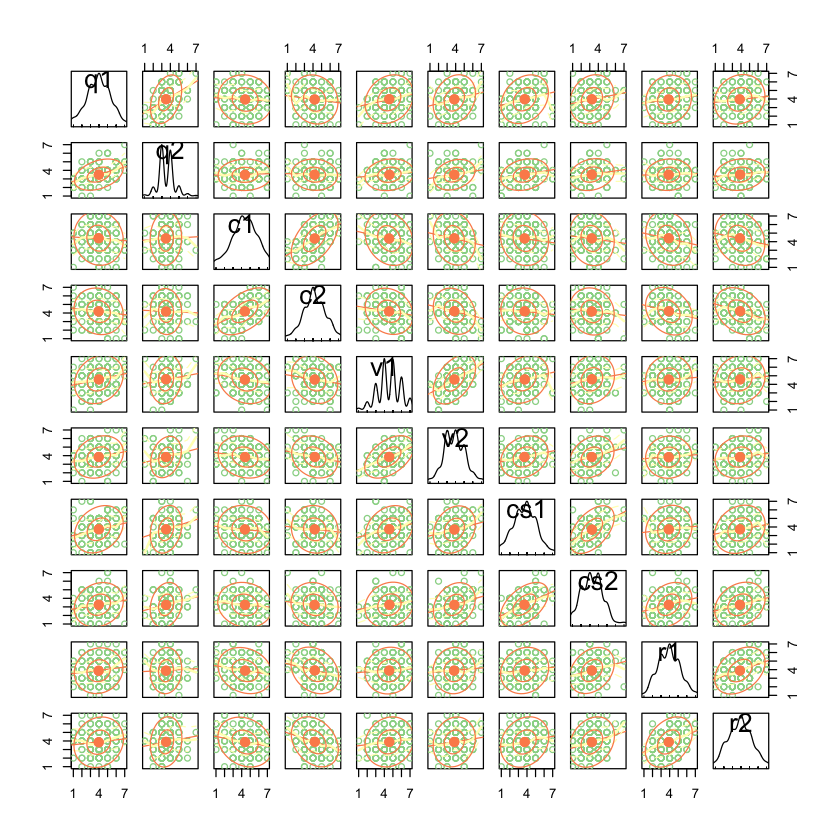

In [23]:
scatterplotMatrix(satSimData[, c(1, 2, 4, 5, 7, 8, 10, 11, 13, 14)], 
                  col=brewer.pal(3, "Spectral"), ellipse=TRUE )

In [24]:
sat.fit <- sem(satModel, data= satSimData, std.lv=TRUE)
summary(sat.fit, fit.measures=TRUE)

lavaan (0.5-20) converged normally after  24 iterations

  Number of observations                           200

  Estimator                                         ML
  Minimum Function Test Statistic               85.454
  Degrees of freedom                                84
  P-value (Chi-square)                           0.435

Model test baseline model:

  Minimum Function Test Statistic              822.848
  Degrees of freedom                               105
  P-value                                        0.000

User model versus baseline model:

  Comparative Fit Index (CFI)                    0.998
  Tucker-Lewis Index (TLI)                       0.997

Loglikelihood and Information Criteria:

  Loglikelihood user model (H0)              -4551.471
  Loglikelihood unrestricted model (H1)      -4508.744

  Number of free parameters                         36
  Akaike (AIC)                                9174.942
  Bayesian (BIC)                              9293.681
  Sample-

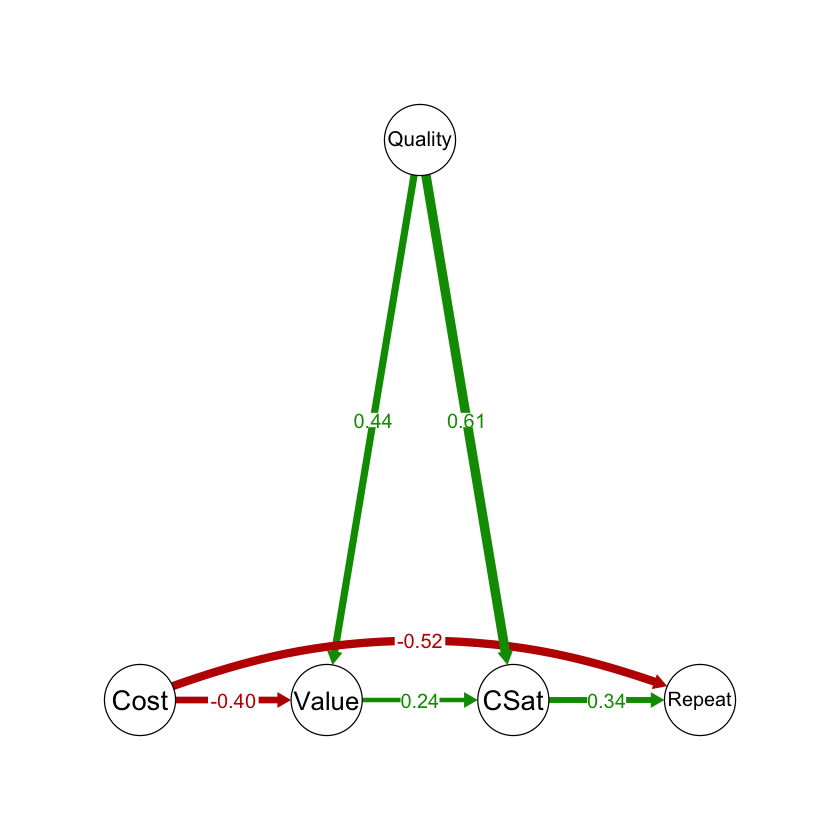

In [25]:
semPaths(sat.fit, what="est", fade=FALSE, residuals=FALSE, 
         layout="tree", structural=TRUE, nCharNodes=7, edge.label.cex=1)

In [26]:
# now define a simpler test model
# let each latent only influence one other latent
satAltModel <- " Quality =~ CSat  + q1 + q2 + q3 + 0*Cost
                 Cost    =~ Value + c1 + c2 + c3
                 Value   =~ CSat  + v1 + v2 + v3
                 CSat    =~ Repeat + cs1 + cs2 + cs3
                 Repeat  =~ r1 + r2 + r3 "

In [27]:
satAlt.fit <- sem(satAltModel, data=satSimData, std.lv=TRUE)
compareFit(sat.fit, satAlt.fit, nested=TRUE)

################### Nested Model Comparison #########################
                       chi df      p delta.cfi
sat.fit - satAlt.fit 37.51  2  <.001    0.0495

#################### Fit Indices Summaries ##########################
             chisq df pvalue   cfi   tli       aic       bic rmsea  srmr
sat.fit     85.454 84  .435† .998† .997† 9174.942† 9293.681† .009† .052†
satAlt.fit 122.962 86  .006  .949  .937  9208.449  9320.592  .046  .095 

### The Partial Least Squares (PLS) Alternative

CB-SEM requires that a data set complies with relatively strict assump- tions about data distributions (continuous data, normally distributed residuals), the number of indicators per factor (generally three or more), reliability of indicators, and sample size (some authorities recommend several hundred, although it is pos- sible that samples of N = 100 or even N = 50 may be adequate when measures are very reliable; see Iacobucci [84]).

When data do not comply with the assumptions of CB-SEM or come from a modest sample size with potentially less reliable indicators, an alternative is partial least squares structural equation modeling (PLS-SEM).

In [28]:
# create a smaller data set, N=50 instead of 200 by sampling from satSimData
set.seed(90704)
satSimData2 <- satSimData[sample(nrow(satSimData), 50), ]
describe(satSimData2)

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
q1,1,50,3.8,1.385051,4,3.75,1.4826,1,7,6,0.2619459,-0.2327089,0.1958758
q2,2,50,3.52,0.8141604,3,3.5,1.4826,2,5,3,0.1593857,-0.6010276,0.1151397
q3,3,50,3.86,1.143036,4,3.825,1.4826,2,7,5,0.268186,0.0540478,0.1616497
c1,4,50,4.38,1.243596,4,4.375,1.4826,1,7,6,-0.04297705,0.2995284,0.175871
c2,5,50,4.2,1.340119,4,4.2,1.4826,1,7,6,-0.05983187,-0.1565017,0.1895214
c3,6,50,4.62,1.368598,5,4.7,1.4826,1,7,6,-0.4808111,-0.213706,0.193549
v1,7,50,4.68,1.284762,5,4.675,1.4826,2,7,5,-0.02562242,-0.7368091,0.1816927
v2,8,50,4.02,1.097121,4,4.025,1.4826,2,6,4,-0.03845598,-1.190794,0.1551563
v3,9,50,4.82,1.082137,5,4.775,1.4826,2,7,5,0.1621964,-0.09481859,0.1530373
cs1,10,50,3.66,1.22241,4,3.65,1.4826,1,7,6,0.1932477,-0.2811028,0.1728749


In [29]:
# the measurement model (manifest variables)
satPLSmm <- matrix(c(
  "Quality", "q1",
  "Quality", "q2",
  "Quality", "q3",
  "Cost",    "c1",
  "Cost",    "c2",
  "Cost",    "c3",
  "Value",   "v1",
  "Value",   "v2",
  "Value",   "v3",
  "CSat",    "cs1",
  "CSat",    "cs2",
  "CSat",    "cs3",
  "Repeat",  "r1",
  "Repeat",  "r2",
  "Repeat",  "r3" ), ncol=2, byrow=TRUE)

In [30]:
# specify the structural model (latent variable relationships)
# in "from, to" format: Col1 == "arrow from", Col2 == "arrow to"
satPLSsm <- matrix(c(
  "Quality", "CSat",
  "Quality", "Value",
  "Cost",    "Value",
  "Cost",    "Repeat",
  "Value",   "CSat",
  "CSat",    "Repeat" ), ncol=2, byrow=TRUE)

In [31]:
library(semPLS)
satPLS.mod <- plsm(data=satSimData2, strucmod=satPLSsm, measuremod=satPLSmm)
satPLS.fit <- sempls(model=satPLS.mod, data=satSimData2)

Loading required package: lattice


All 50 observations are valid.
Converged after 14 iterations.
Tolerance: 1e-07
Scheme: centroid


In [32]:
# the manifest variable loadings (measurement model)
plsLoadings(satPLS.fit)

    Cost Quality Value CSat Repeat
c1  0.39       .     .    .      .
c2  0.82       .     .    .      .
c3  0.78       .     .    .      .
q1     .    0.54     .    .      .
q2     .    0.83     .    .      .
q3     .    0.90     .    .      .
v1     .       .  0.77    .      .
v2     .       .  0.91    .      .
v3     .       .  0.61    .      .
cs1    .       .     . 0.47      .
cs2    .       .     . 0.82      .
cs3    .       .     . 0.69      .
r1     .       .     .    .   0.69
r2     .       .     .    .   0.93
r3     .       .     .    .   0.58

In [33]:
# examine the structural coefficients (structural model)
pathCoeff(satPLS.fit)

        Cost Quality  Value   CSat Repeat
Cost       .       . -0.196      . -0.393
Quality    .       .  0.323  0.400      .
Value      .       .      .  0.062      .
CSat       .       .      .      .  0.231
Repeat     .       .      .      .      .

** Assessing the PLS-SEM Model **
- Examine the model’s coefficients for intelligibility, as we did in Sect. 10.4.1
- Examine the overall R2 for the model, and determine (largely subjectively)
whether sufficient variance is explained to be useful 
- Bootstrap the model to examine coefficient stability

In [34]:
rSquared(satPLS.fit)

        R-squared
Cost            .
Quality         .
Value        0.18
CSat         0.18
Repeat       0.26

In [39]:
set.seed(04460)
satPLS.boot <- bootsempls(satPLS.fit, nboot=70, start="ones")
summary(satPLS.boot, type = "bca", level = 0.9)

Resample:  1 1 2 3 4 5 6 7 8 910111213141516171819202122232425262728293031323334353637383940414243444546474849505152535455565758596061626364656667686970 Done.


Warning message:
In bootsempls(satPLS.fit, nboot = 70, start = "ones"): There were 65 apparent convergence failures;
  these are discarded from the 70 bootstrap replications returned.Warning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpointsWarning message:
In norm.inter(t, adj.alpha): extreme order statistics used as endpoints

Call: bootsempls(object = satPLS.fit, nboot = 70, start = "ones")

Lower and upper limits are for the 90 percent bca confidence interval

         Estimate     Bias Std.Error     Lower   Upper
lam_1_1    0.3920  0.00274    0.1973 -0.001586 0.61667
lam_1_2    0.8232 -0.00719    0.0900  0.434417 0.88909
lam_1_3    0.7797 -0.03041    0.1534  0.612541 0.90421
lam_2_1    0.5429  0.01645    0.2500 -0.442773 0.78429
lam_2_2    0.8298 -0.02008    0.1160  0.731383 0.90745
lam_2_3    0.8977 -0.01129    0.0512  0.779221 0.93784
lam_3_1    0.7665  0.03254    0.0890  0.515099 0.84693
lam_3_2    0.9064 -0.05992    0.1462  0.783655 0.98573
lam_3_3    0.6125  0.04456    0.1406  0.173876 0.76943
lam_4_1    0.4744  0.05963    0.2070 -0.148684 0.76243
lam_4_2    0.8190 -0.01821    0.0793  0.717459 0.94754
lam_4_3    0.6924 -0.05470    0.2018  0.384797 0.88702
lam_5_1    0.6919 -0.00150    0.1401  0.007367 0.79946
lam_5_2    0.9264 -0.02496    0.0431  0.896240 0.98401
lam_5_3    0.5843  0.04358    0.1657 

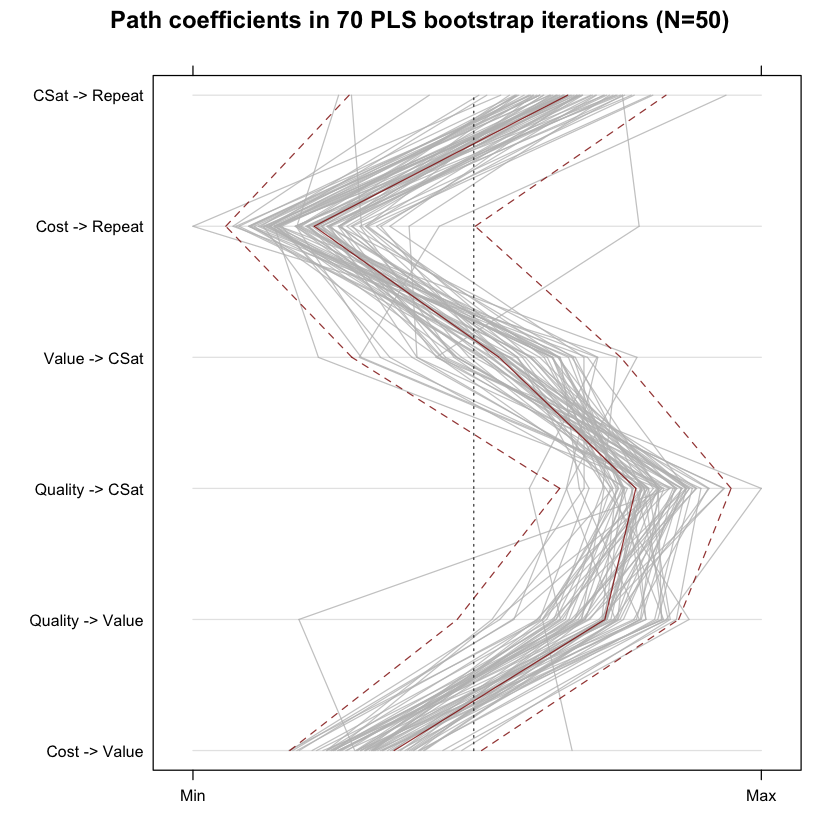

In [40]:
parallelplot(satPLS.boot, reflinesAt = 0, alpha=0.8,
  varnames=attr(satPLS.boot$t, "path")[16:21],
  main="Path coefficients in 70 PLS bootstrap iterations (N=50)")

In [41]:
# now what if we use the FULL N=200 dataset (instead of N=50)?
satPLS.modF <- plsm(data=satSimData, strucmod=satPLSsm, measuremod=satPLSmm)
satPLS.fitF <- sempls(model=satPLS.mod, data=satSimData)

All 200 observations are valid.
Converged after 7 iterations.
Tolerance: 1e-07
Scheme: centroid


In [42]:
# check its coefficients and fit
pathCoeff(satPLS.fitF)

        Cost Quality Value  CSat Repeat
Cost       .       . -0.27     .  -0.32
Quality    .       .  0.30  0.34      .
Value      .       .     .  0.22      .
CSat       .       .     .     .   0.29
Repeat     .       .     .     .      .

In [43]:
# bootstrap PLS
set.seed(04460)
satPLS.bootF <- bootsempls(satPLS.fitF, nboot=500, start="ones")
# summary(satPLS.bootF, type = "bca", level = 0.9)

Resample:   1  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99100101102103104105106107108109110111112113114115116117118119120121122123124125126127128129130131132133134135136137138139140141142143144145146147148149150151152153154155156157158159160161162163164

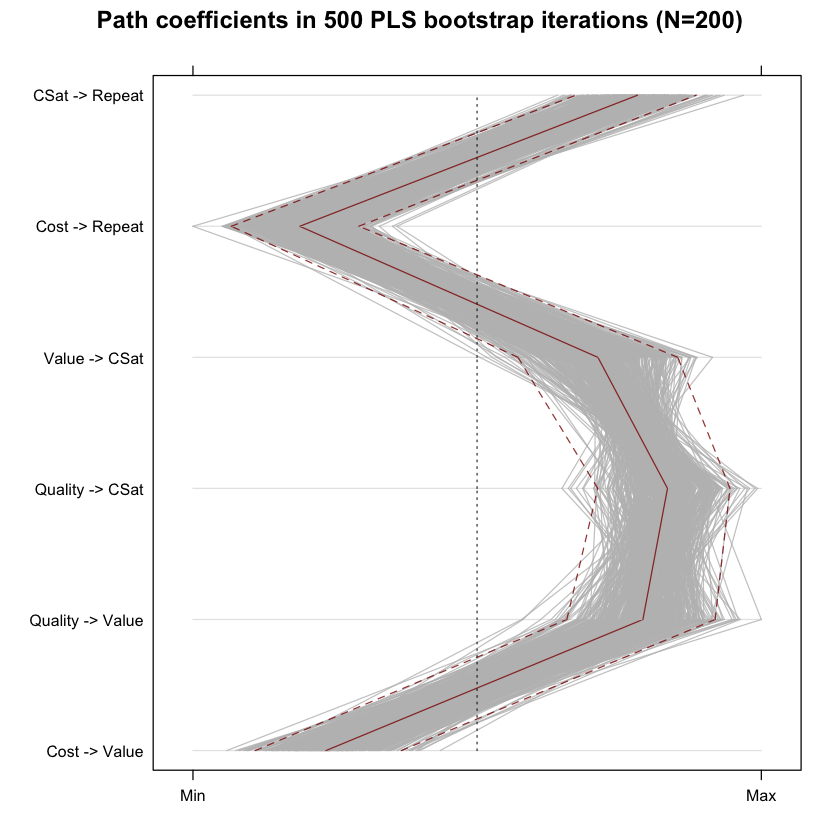

In [44]:
parallelplot(satPLS.bootF, reflinesAt = 0, alpha=0.8,
  varnames=attr(satPLS.bootF$t, "path")[16:21],
  main="Path coefficients in 500 PLS bootstrap iterations (N=200)")

- Learn about structural models and their assumptions; do not fit them blindly. If you become discouraged by mathematical treatments, keep looking; the con- cepts can be challenging but there are excellent and readable expositions such as Kline [92].
- A structural equation model (SEM) relates observed manifest variables—such as data points or survey responses—to underlying latent variables. It estimates the strength of associations in a proposed model, as well as the degree to which the model fits the observed data.
- SEM may be used to check the factor structure of survey items and their rela- tionships to proposed latent variables; this is known as CFA. A good practice in survey research is to assess those relationships; do not simply assume that sur- vey items relate to one another or to latent constructs as expected (Sect. 10.2).
- SEM can also be used to test more complex models, in which latent variables affect one another and are related to multiple sets of manifest variables.
- TwogeneralapproachestoSEMarethecovariance-basedapproach(CB-SEM), which attempts to model the relationships among the variables at once and thus is a strong test of the model, and the partial least squares approach (PLS-SEM), which fits parts of the data sequentially and has less stringent requirements.
- After you specify a CB-SEM model, simulate a data set using simulateData() from lavaan with reasonable guesses as to variable loadings. Use the simulated data to determine whether your model is likely to converge for the sample size you expect.
- Plot your specified model graphically and inspect it carefully to check that it is the model you intended to estimate.
- Whenever possible, specify one or two alternative models and check those in addition to your model. Before accepting a CB-SEM model, use compareFit() to demonstrate that your model fits the data better than alternatives.
- If you have data of varying quality, nominal categories, small sample, or problems converging a CB-SEM model, consider partial least squares SEM (PLS-SEM).
- For PLS-SEM, use a bootstrap procedure (such as bootsempls() in the semPLS package) to examine the stability of coefficients.